In [2]:
import cv2
import os
import imageio
from IPython.display import Image
import sys
from timeit import default_timer as timer
from tqdm.auto import tqdm
from sklearn.preprocessing import StandardScaler

import dask
from dask import delayed

import warnings
warnings.filterwarnings("ignore")

import numpy as np
from scipy.sparse import csr_matrix, save_npz
import seaborn as sn
import matplotlib.pyplot as plt
from sklearn.decomposition import TruncatedSVD, PCA
try:
    import cvxpy as cvx
except ModuleNotFoundError:
    ! pip -U install cvxpy -q
    import cvxpy as cvx
    print(cvx.__version__)

def GetYT_video(link):
    try:
        from pytube import YouTube
    except ModuleNotFoundError:
        ! pip install pytube -q
        from pytube import YouTube
    print("Dowmloading video .....")
    YouTube(link).streams.first().download()
    print("downloaded!")
    return None

link = r"https://www.youtube.com/watch?v=e2et8qXCjBA"
GetYT_video(link)

import gdown
url = "https://drive.google.com/drive/folders/1Y_lOg92-IzGAbn4PXWVDs4WbYtbGMqmM?usp=drive_link"
gdown.download_folder(url)

Dowmloading video .....
downloaded!


Retrieving folder contents


Processing file 1_EgZIun0rs278SNRCgzV7UDsuTNsVPKt input.avi
Processing file 1UxqIgw6IzDzX7p7iPKtMOEOICBYwTqoV Leopard_Attack.mp4
Processing file 1prpCJwdjqNDAkN2V50XMEPoc3q7O8vc4 waving_bottle.mp4
Processing file 1fJ6bKK5wUhP3W54kPxbZLKuoXuZ7J-Id waving_tree.mp4


Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1_EgZIun0rs278SNRCgzV7UDsuTNsVPKt
To: /content/dataset/input.avi
100%|██████████| 7.88M/7.88M [00:00<00:00, 48.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=1UxqIgw6IzDzX7p7iPKtMOEOICBYwTqoV
To: /content/dataset/Leopard_Attack.mp4
100%|██████████| 1.16M/1.16M [00:00<00:00, 12.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1prpCJwdjqNDAkN2V50XMEPoc3q7O8vc4
To: /content/dataset/waving_bottle.mp4
100%|██████████| 1.14M/1.14M [00:00<00:00, 20.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=1fJ6bKK5wUhP3W54kPxbZLKuoXuZ7J-Id
To: /content/dataset/waving_tree.mp4
100%|██████████| 698k/698k [00:00<00:00, 9.00MB/s]
Download completed


['/content/dataset/input.avi',
 '/content/dataset/Leopard_Attack.mp4',
 '/content/dataset/waving_bottle.mp4',
 '/content/dataset/waving_tree.mp4']

In [ ]:
# ! curl -Lo Hopkins155WithVideosPart7.zip http://www.vision.jhu.edu/data/fetchdata.php?id=27 -v
# ! unzip -q -o Hopkins155WithVideosPart7.zip -d Hopkins155WithVideosPart7
# ! rm -rf /content/Hopkins155WithVideosPart7.zip

In [ ]:
# ! curl -Lo Avenue_Dataset.zip http://www.cse.cuhk.edu.hk/leojia/projects/detectabnormal/Avenue_Dataset.zip -v
# ! unzip -q -o /content/Avenue_Dataset.zip -d /content/Avenue_Dataset
# ! rm -rf /content/Avenue_Dataset.zip

In [ ]:
# !rm -rf /content/outputs /content/output.mp4

Total number of frames: 900
Frame rate: 30.0
Width: 640 Height: 360


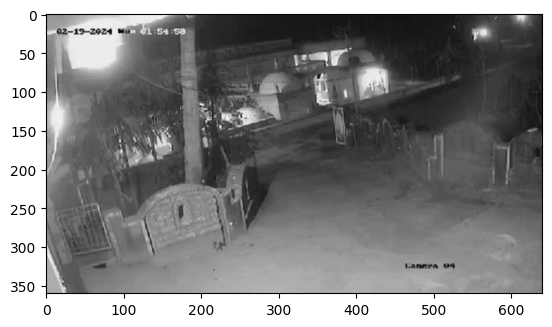

In [3]:
# VIDEO_PATH = r'/content/dataset/waving_tree.mp4'
# VIDEO_PATH = r'/content/Hopkins155WithVideosPart7/cars5/cars5.avi'
VIDEO_PATH = r'/content/Leopard Attack  Dog taken by Leopard in India animals.mp4'
VIDEO_NAME = VIDEO_PATH.split("/")[-1].split(".")[0]


video = cv2.VideoCapture(VIDEO_PATH)

frame_fps = video.get(cv2.CAP_PROP_FPS)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

print("Total number of frames:", frame_count)
print("Frame rate:", frame_fps)
print("Width:", frame_width, "Height:", frame_height)

ret, frame = video.read()
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
plt.imshow(frame, cmap='gray')

Reading frames: 
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273

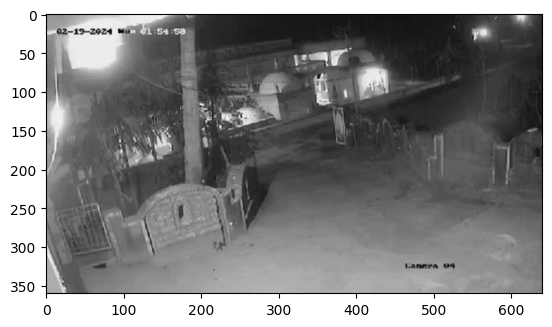

In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH)
frame_size = int(frame_width*frame_height)


frames = np.empty((0, frame_size), np.uint8)
frames_arr_typ = str(type(frames)).split("'")[-2].split(".")[0]
frame_count = 0

start_time = timer()
while True:
    ret, frame = cap.read()
    if not ret:
        break
    else:
        frame_count += 1
        if frame_count == 1:
            print("Reading frames: ")
        print(f"{frame_count}", end=" ")

        if len(frame.shape) == 3:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        frames = np.append(frames, [frame.flatten()], axis=0)

end_time = timer()

print(f"\nExecuted the code in {end_time - start_time} seconds")

total_memory = frames.nbytes / (1024 * 1024)
print(f'Total memory usage of {frames_arr_typ} array (in MB): {total_memory}')

print(frames.shape)
print(frames)
plt.imshow(frames[0].reshape(frame_height, frame_width), cmap='gray'); plt.show()

In [5]:
def is_outlier(frame):

    try:
        import cvxpy as cvx
    except ModuleNotFoundError:
        ! pip -U install cvxpy -q
        import cvxpy as cvx

    import numpy as np

    if len(frame.shape) == 3:
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    else:
        frame_gray = frame

    pca = PCA(n_components=0.90)
    frame_gray_reduced = pca.fit_transform(frame_gray)

    M1, M2 = frame_gray_reduced.shape
    rd = M1

    C = cvx.Variable((rd, M2))
    constraints = [cvx.diag(C.T @ frame_gray_reduced) == 1]
    objective = cvx.Minimize(cvx.norm(C.T @ frame_gray_reduced, p=1))
    problem = cvx.Problem(objective, constraints)


    problem.solve(solver = cvx.ECOS, verbose=False)

    x = 1 / np.linalg.norm(frame_gray_reduced.T @ C.value, axis=0, ord=1)
    mean_x = np.mean(x)
    std_x = np.std(x)
    z_scores = (x - mean_x) / std_x
    threshold = 3

    # return np.max(z_scores) > threshold
    return frame_gray, frame_gray_reduced, x, C.value, threshold, z_scores, np.max(z_scores), pca.inverse_transform(frame_gray_reduced)

In [6]:
def process_frame(frame):
    D, D_new, x, C_star, t, z_score, z_score_max, D_inv = is_outlier(frame)
    return z_score_max

video = cv2.VideoCapture(VIDEO_PATH)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

frame_counter = 0
pbar = tqdm(desc='Reading Frames', total=frame_count)
Z_max = []
while(video.isOpened()):
    ret, frame = video.read()
    if ret:
        Z_max.append(delayed(process_frame)(frame))
        frame_counter += 1
        pbar.update(1)
    else:
        break


Z_max = dask.compute(*Z_max, num_workers=os.cpu_count())
Z_max = np.array(Z_max)
Z_max.shape

Reading Frames:   0%|          | 0/900 [00:00<?, ?it/s]

(900,)

In [7]:
Z_max

array([1.75270766, 1.4297657 , 0.9024632 , 1.09686161, 1.40119307,
       1.78404193, 1.78629149, 1.78946969, 1.54989278, 2.23718666,
       1.22058019, 1.11043662, 1.81239614, 1.81080377, 1.62956065,
       1.81118479, 1.60309014, 0.87049645, 0.87049645, 1.82055792,
       1.74947476, 1.19110338, 1.52235129, 1.82471236, 1.83237099,
       1.84527884, 1.90165801, 1.80570592, 1.80708689, 1.79951621,
       1.80170746, 1.18591913, 2.5967002 , 1.95497848, 1.82344735,
       1.88675269, 1.88596379, 1.88382075, 0.90079258, 1.9140932 ,
       0.85624494, 1.01991552, 1.0229957 , 1.9021606 , 2.0040414 ,
       1.18145292, 2.41775385, 1.37788629, 1.92135842, 1.94948163,
       2.45657789, 1.92781018, 2.67760735, 1.94981974, 1.67299348,
       1.94854905, 1.94636124, 1.95163575, 0.99649239, 1.94384252,
       1.30172726, 1.17429342, 1.97319589, 1.97330001, 1.97434752,
       1.9723079 , 1.92884652, 1.16192785, 1.93554261, 2.47607482,
       1.93593993, 1.94727057, 1.63483038, 2.3994727 , 1.30549

82 82 2.6238666936561392


[]

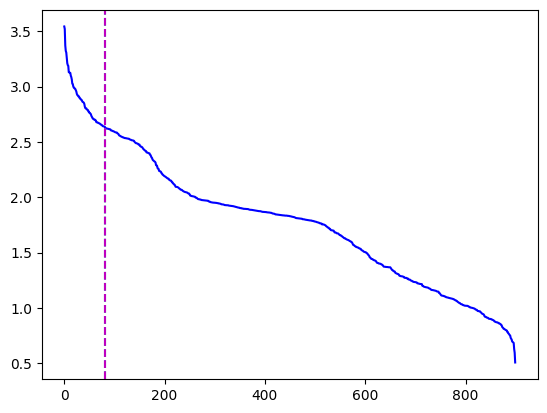

In [8]:
def Find_Knee(arr):
    try:
        from kneed import DataGenerator, KneeLocator
    except ModuleNotFoundError:
        !pip install kneed -q
        !pip install kneed[plot] -q
        from kneed import DataGenerator, KneeLocator

    x = np.arange(len(arr))
    y = np.sort(arr)[::-1]
    kneedle = KneeLocator(x, y, S=3.0, curve="convex", direction="decreasing")
    return kneedle.knee, kneedle.elbow, kneedle.knee_y

k, e, ky = Find_Knee(Z_max)
print(k, e, ky)

plt.plot(Z_max[np.argsort(Z_max)[::-1]], c='b')
plt.axvline(x=k, color='c', linestyle='--', label='Knee')
plt.axvline(x=e, color='m', linestyle='--', label='Knee')
plt.plot()

In [9]:
# print(Z_max)
k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
Z_idx, k

(array([573, 525, 252, 268, 473, 386, 243, 291, 278, 330, 331, 592, 447,
        567, 596, 303, 476, 540, 280, 239, 304, 342, 390, 564, 352, 348,
        409, 275, 552, 553, 326, 577, 384, 538, 310, 454, 444, 582, 477,
        495, 486, 267, 299, 459, 363, 482, 452, 537, 376, 257, 488, 574,
        539, 566, 400, 841, 489, 562, 463, 788, 580, 413, 242, 654, 467,
         52, 827, 490, 768, 298, 253, 511, 510, 557, 412, 501, 311, 536,
        367, 368, 492, 419, 835, 289, 533, 284, 236,  87, 141, 503, 277,
        519, 283, 391, 402, 355, 843, 260,  32, 266, 520, 244, 751, 293,
        682, 427, 393, 578, 563, 248, 377, 527, 848, 327, 287, 378, 341,
        756, 401, 380, 335, 321, 307, 547,  97, 224, 305, 309, 302, 261,
        320, 422, 585, 620, 263, 518, 259, 314, 478, 887, 373, 437, 555,
        847, 513, 274, 491, 255, 735,  69, 387, 561, 481, 696,  50, 113,
        646, 881, 506, 458, 316, 897,  46, 344, 204, 431, 722, 504,  73,
        382, 223, 487,  90, 609, 517, 526, 254, 462

In [10]:
outlier_frames_idx = Z_idx[:k]
outlier_frames_idx

array([573, 525, 252, 268, 473, 386, 243, 291, 278, 330, 331, 592, 447,
       567, 596, 303, 476, 540, 280, 239, 304, 342, 390, 564, 352, 348,
       409, 275, 552, 553, 326, 577, 384, 538, 310, 454, 444, 582, 477,
       495, 486, 267, 299, 459, 363, 482, 452, 537, 376, 257, 488, 574,
       539, 566, 400, 841, 489, 562, 463, 788, 580, 413, 242, 654, 467,
        52, 827, 490, 768, 298, 253, 511, 510, 557, 412, 501, 311, 536,
       367, 368, 492, 419])

In [11]:
Z_max[outlier_frames_idx]

array([3.54263097, 3.51996095, 3.3705163 , 3.32189163, 3.30717506,
       3.26051066, 3.2106939 , 3.19354828, 3.18634804, 3.12924606,
       3.12924606, 3.12449799, 3.12337244, 3.09805002, 3.08564511,
       3.06444068, 3.02624292, 3.02235765, 3.00044302, 2.99004421,
       2.98909434, 2.98060788, 2.97813165, 2.96785832, 2.95558406,
       2.93477595, 2.92344008, 2.9205156 , 2.91166   , 2.91166   ,
       2.90389123, 2.89261822, 2.89161734, 2.88448466, 2.87910827,
       2.87732243, 2.8646248 , 2.86011299, 2.85870357, 2.8535758 ,
       2.842613  , 2.81807516, 2.80492672, 2.80321665, 2.80282529,
       2.79331614, 2.79010361, 2.78880688, 2.77498317, 2.77420431,
       2.7630648 , 2.76247743, 2.7551307 , 2.75101523, 2.73576923,
       2.72770585, 2.71772198, 2.70996834, 2.70883651, 2.70245896,
       2.70172287, 2.7015643 , 2.69429466, 2.69328788, 2.67810089,
       2.67760735, 2.67618108, 2.67236393, 2.67214482, 2.66885027,
       2.66644019, 2.66482601, 2.66082128, 2.65589106, 2.65509

In [ ]:
video = cv2.VideoCapture(VIDEO_PATH)

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(f'{VIDEO_NAME}_output.mp4', fourcc, frame_fps, (frame_width, frame_height))

frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
outlier_frames_idx = Z_idx[:k]


num_cols = 5
num_rows = (frame_count + num_cols - 1) // num_cols

fig, axs = plt.subplots(num_rows, num_cols, figsize=(19, num_rows*3)  )

frame_counter = 0

pbar = tqdm(desc='Reading Frames', total=frame_count)
while(video.isOpened()):

    ret, frame = video.read()
    if ret:
        if frame_counter < frame_count:
            row = frame_counter // num_cols
            col = frame_counter % num_cols

            axs[row, col].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            if frame_counter in outlier_frames_idx:
                cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (252, 65, 0), 2, cv2.LINE_AA)
                axs[row, col].set_title(f'Outlier Detected - Frame {frame_counter}', color='red')
                axs[row, col].set_frame_on(True)
            else:
                axs[row, col].set_title(f'Frame {frame_counter}')
            axs[row, col].axis('off')

        frame_counter += 1

        out.write(frame)
        pbar.update(1)

    else:
        break

# plt.tight_layout()
out.release()
plt.show()

Reading Frames:   0%|          | 0/900 [00:00<?, ?it/s]

In [ ]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt
# from tqdm import tqdm

# # Assuming you have defined Find_Knee and Z_max elsewhere in your code
# # Also assuming you have the frame_width and frame_height defined

# # VIDEO_PATH = "path/to/your/video.mp4"  # Replace this with your video path
# video = cv2.VideoCapture(VIDEO_PATH)

# frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# k = Find_Knee(Z_max)[0]
# Z_idx = np.argsort(Z_max)[::-1]
# outlier_frames_idx = Z_idx[:k]

# frame_counter = 0
# pbar = tqdm(desc='Reading Frames', total=frame_count)

# # Calculate number of rows and columns for subplot
# num_frames = min(frame_count, 99)  # Use minimum of frame_count and 99
# num_cols = 5
# num_rows = (num_frames + num_cols - 1) // num_cols  # Round up division

# # Create subplots dynamically
# fig, axs = plt.subplots(num_rows, num_cols, figsize=(19, num_rows*3))

# while(video.isOpened()):

#     ret, frame = video.read()
#     if ret:
#         if frame_counter < 99:
#             row = frame_counter // num_cols
#             col = frame_counter % num_cols


#             axs[row, col].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
#             if frame_counter in outlier_frames_idx:
#                 axs[row, col].set_title(f'Outlier Detected - Frame {frame_counter}', color='red')  # Set title color to red
#                 axs[row, col].set_frame_on(True)  # Turn on the frame around the subplot

#             else:
#                 axs[row, col].set_title(f'Frame {frame_counter}')
#             axs[row, col].axis('off')

#         frame_counter += 1
#         pbar.update(1)

#     else:
#         break

# # Tight layout to prevent overlap
# plt.tight_layout()

# # Save the plot as a video
# fourcc = cv2.VideoWriter_fourcc(*'mp4v')
# out = cv2.VideoWriter('output.mp4', fourcc, 30, (frame_width, frame_height))

# for _ in range(frame_count):
#     out.write(frame)

# out.release()
# plt.show()


In [ ]:
VIDEO_PATH = r'/content/dataset/waving_tree.mp4'
VIDEO_NAME = VIDEO_PATH.split("/")[-1].split(".")[0]


video = cv2.VideoCapture(VIDEO_PATH)

frame_fps = video.get(cv2.CAP_PROP_FPS)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

print("Total number of frames:", frame_count)
print("Frame rate:", frame_fps)
print("Width:", frame_width, "Height:", frame_height)

ret, frame = video.read()
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
plt.imshow(frame, cmap='gray')

In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH)
frame_size = int(frame_width*frame_height)


frames = np.empty((0, frame_size), np.uint8)
frames_arr_typ = str(type(frames)).split("'")[-2].split(".")[0]
frame_count = 0

start_time = timer()
while True:
    ret, frame = cap.read()
    if not ret:
        break
    else:
        frame_count += 1
        if frame_count == 1:
            print("Reading frames: ")
        print(f"{frame_count}", end=" ")

        if len(frame.shape) == 3:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        frames = np.append(frames, [frame.flatten()], axis=0)

end_time = timer()

print(f"\nExecuted the code in {end_time - start_time} seconds")

total_memory = frames.nbytes / (1024 * 1024)
print(f'Total memory usage of {frames_arr_typ} array (in MB): {total_memory}')

print(frames.shape)
print(frames)
plt.imshow(frames[0].reshape(frame_height, frame_width), cmap='gray'); plt.show()

In [ ]:
def is_outlier(frame):

    try:
        import cvxpy as cvx
    except ModuleNotFoundError:
        ! pip -U install cvxpy -q
        import cvxpy as cvx

    import numpy as np

    if len(frame.shape) == 3:
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    else:
        frame_gray = frame

    pca = PCA(n_components=0.90)
    frame_gray_reduced = pca.fit_transform(frame_gray)

    M1, M2 = frame_gray_reduced.shape
    rd = M1

    C = cvx.Variable((rd, M2))
    constraints = [cvx.diag(C.T @ frame_gray_reduced) == 1]
    objective = cvx.Minimize(cvx.norm(C.T @ frame_gray_reduced, p=1))
    problem = cvx.Problem(objective, constraints)


    problem.solve(solver = cvx.ECOS, verbose=False)

    x = 1 / np.linalg.norm(frame_gray_reduced.T @ C.value, axis=0, ord=1)
    mean_x = np.mean(x)
    std_x = np.std(x)
    z_scores = (x - mean_x) / std_x
    threshold = 3

    # return np.max(z_scores) > threshold
    return frame_gray, frame_gray_reduced, x, C.value, threshold, z_scores, np.max(z_scores), pca.inverse_transform(frame_gray_reduced)

In [ ]:
def process_frame(frame):
    D, D_new, x, C_star, t, z_score, z_score_max, D_inv = is_outlier(frame)
    return z_score_max

video = cv2.VideoCapture(VIDEO_PATH)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

frame_counter = 0
pbar = tqdm(desc='Reading Frames', total=frame_count)
Z_max = []
while(video.isOpened()):
    ret, frame = video.read()
    if ret:
        Z_max.append(delayed(process_frame)(frame))
        frame_counter += 1
        pbar.update(1)
    else:
        break


Z_max = dask.compute(*Z_max, num_workers=os.cpu_count())
Z_max = np.array(Z_max)
Z_max.shape

In [ ]:
Z_max

In [ ]:
def Find_Knee(arr):
    try:
        from kneed import DataGenerator, KneeLocator
    except ModuleNotFoundError:
        !pip install kneed -q
        !pip install kneed[plot] -q
        from kneed import DataGenerator, KneeLocator

    x = np.arange(len(arr))
    y = np.sort(arr)[::-1]
    kneedle = KneeLocator(x, y, S=3.0, curve="convex", direction="decreasing")
    return kneedle.knee, kneedle.elbow, kneedle.knee_y

k, e, ky = Find_Knee(Z_max)
print(k, e, ky)

plt.plot(Z_max[np.argsort(Z_max)[::-1]], c='b')
plt.axvline(x=k, color='c', linestyle='--', label='Knee')
plt.axvline(x=e, color='m', linestyle='--', label='Knee')
plt.plot()

In [ ]:
# print(Z_max)
k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
Z_idx, k

In [ ]:
outlier_frames_idx = Z_idx[:k]
outlier_frames_idx

In [ ]:
Z_max[outlier_frames_idx]

In [ ]:
video = cv2.VideoCapture(VIDEO_PATH)

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(f'{VIDEO_NAME}_output.mp4', fourcc, frame_fps, (frame_width, frame_height))

frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
outlier_frames_idx = Z_idx[:k]


num_cols = 5
num_rows = (frame_count + num_cols - 1) // num_cols

fig, axs = plt.subplots(num_rows, num_cols, figsize=(19, num_rows*3)  )

frame_counter = 0

pbar = tqdm(desc='Reading Frames', total=frame_count)
while(video.isOpened()):

    ret, frame = video.read()
    if ret:
        if frame_counter < frame_count:
            row = frame_counter // num_cols
            col = frame_counter % num_cols

            axs[row, col].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            if frame_counter in outlier_frames_idx:
                cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (252, 65, 0), 2, cv2.LINE_AA)
                axs[row, col].set_title(f'Outlier Detected - Frame {frame_counter}', color='red')
                axs[row, col].set_frame_on(True)
            else:
                axs[row, col].set_title(f'Frame {frame_counter}')
            axs[row, col].axis('off')

        frame_counter += 1

        out.write(frame)
        pbar.update(1)

    else:
        break

# plt.tight_layout()
out.release()
plt.show()

In [ ]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt
# from tqdm import tqdm

# # Assuming you have defined Find_Knee and Z_max elsewhere in your code
# # Also assuming you have the frame_width and frame_height defined

# # VIDEO_PATH = "path/to/your/video.mp4"  # Replace this with your video path
# video = cv2.VideoCapture(VIDEO_PATH)

# frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# k = Find_Knee(Z_max)[0]
# Z_idx = np.argsort(Z_max)[::-1]
# outlier_frames_idx = Z_idx[:k]

# frame_counter = 0
# pbar = tqdm(desc='Reading Frames', total=frame_count)

# # Calculate number of rows and columns for subplot
# num_frames = min(frame_count, 99)  # Use minimum of frame_count and 99
# num_cols = 5
# num_rows = (num_frames + num_cols - 1) // num_cols  # Round up division

# # Create subplots dynamically
# fig, axs = plt.subplots(num_rows, num_cols, figsize=(19, num_rows*3))

# while(video.isOpened()):

#     ret, frame = video.read()
#     if ret:
#         if frame_counter < 99:
#             row = frame_counter // num_cols
#             col = frame_counter % num_cols


#             axs[row, col].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
#             if frame_counter in outlier_frames_idx:
#                 axs[row, col].set_title(f'Outlier Detected - Frame {frame_counter}', color='red')  # Set title color to red
#                 axs[row, col].set_frame_on(True)  # Turn on the frame around the subplot

#             else:
#                 axs[row, col].set_title(f'Frame {frame_counter}')
#             axs[row, col].axis('off')

#         frame_counter += 1
#         pbar.update(1)

#     else:
#         break

# # Tight layout to prevent overlap
# plt.tight_layout()

# # Save the plot as a video
# fourcc = cv2.VideoWriter_fourcc(*'mp4v')
# out = cv2.VideoWriter('output.mp4', fourcc, 30, (frame_width, frame_height))

# for _ in range(frame_count):
#     out.write(frame)

# out.release()
# plt.show()


In [ ]:
# video = cv2.VideoCapture(VIDEO_PATH)

# fourcc = cv2.VideoWriter_fourcc(*'mp4v')
# out = cv2.VideoWriter('output.mp4', fourcc, 30, (frame_width, frame_height))

# k = Find_Knee(Z_max)[0]
# Z_idx = np.argsort(Z_max)[::-1]
# outlier_frames_idx = Z_idx[:k]

# frame_counter = 0
# pbar = tqdm(desc='Reading Frames', total=frame_count)

# # Create subplots outside the loop
# fig, axs = plt.subplots(19, 5, figsize=(19, 38))

# while(video.isOpened()):

#     ret, frame = video.read()
#     if ret:
#         if frame_counter < 95:
#             row = frame_counter // 5
#             col = frame_counter % 5

#             # Plot the frame in the corresponding subplot
#             axs[row, col].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
#             if frame_counter in outlier_frames_idx:
#                 axs[row, col].set_title(f'Outlier Detected - Frame {frame_counter}')
#             else:
#                 axs[row, col].set_title(f'Frame {frame_counter}')
#             axs[row, col].axis('off')

#         frame_counter += 1
#         pbar.update(1)

#     else:
#         break

# # Tight layout to prevent overlap
# plt.tight_layout()

# # Save the plot as a video
# for _ in range(frame_count):
#     out.write(frame)

# out.release()
# plt.show()

In [ ]:
# video = cv2.VideoCapture(VIDEO_PATH)

# fourcc = cv2.VideoWriter_fourcc(*'mp4v')
# out = cv2.VideoWriter('output.mp4', fourcc, 20, (frame_width, frame_height))

# k = Find_Knee(Z_max)[0]
# Z_idx = np.argsort(Z_max)[::-1]
# outlier_frames_idx = Z_idx[:k]

# frame_counter = 0
# pbar = tqdm(desc='Reading Frames', total=frame_count)

# while(video.isOpened()):

#     ret, frame = video.read()
#     if ret:

#         plt.figure(figsize=(19,4))

#         if frame_counter in outlier_frames_idx:
#             cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (252, 65, 0), 2, cv2.LINE_AA)

#         plt.imshow(frame, cmap='gray')
#         plt.title(f"Frame {frame_counter} {D.shape}")

#         plt.suptitle(f"D:{D.shape}, D_new:{D_new.shape}, x:{x.shape}, C_star:{C_star.shape}, threshold: {t}, z_score_max:{z_score_max:.2f}, z_score:{z_score.shape}")
#         plt.tight_layout()

#         frame_counter += 1
#         pbar.update(1)

#     else:
#         break

# out.release()

In [ ]:
# video = cv2.VideoCapture(VIDEO_PATH)

# fourcc = cv2.VideoWriter_fourcc(*'mp4v')
# out = cv2.VideoWriter('output.mp4', fourcc, 30, (frame_width, frame_height))

# k = Find_Knee(Z_max)[0]
# Z_idx = np.argsort(Z_max)[::-1]
# Z_idx, k

# frame_counter = 0
# pbar = tqdm(desc='Reading Frames', total=frame_count)

# while(video.isOpened()):

#     ret, frame = video.read()
#     if ret:

#         plt.figure(figsize=(19,4))

#         if np.max(z_score) > t:
#             cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (252, 65, 0), 2, cv2.LINE_AA)
#         plt.imshow(frame, cmap='gray')
#         plt.title(f"Frame {frame_counter} {D.shape}")

#         plt.suptitle(f"D:{D.shape}, D_new:{D_new.shape}, x:{x.shape}, C_star:{C_star.shape}, threshold: {t}, z_score_max:{z_score_max:.2f}, z_score:{z_score.shape}")
#         plt.tight_layout()

#         frame_counter += 1
#         pbar.update(1)

#     else:
#         break

# out.release()

In [ ]:
# video = cv2.VideoCapture(VIDEO_PATH)

# # Define the codec using VideoWriter_fourcc and create a VideoWriter object
# fourcc = cv2.VideoWriter_fourcc(*'mp4v') # Use 'mp4v' for .mp4
# out = cv2.VideoWriter('output.mp4', fourcc, 20.0, (frame_width, frame_height)) # Use the actual frame size

# frame_counter = 0
# pbar = tqdm(desc='Reading Frames', total=frame_count)

# while(video.isOpened()):

#     ret, frame = video.read()
#     if ret:

#         plt.figure(figsize=(19,4))


#         plt.subplot(1,7,6)
#         plt.plot(x[np.argsort(x)[::-1]], c='r')
#         plt.xlabel('Element Index'); plt.ylabel(r'$\mathbf{X}$'); plt.title("Innovation Values")

#         if np.max(z_score) > t:
#             cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (252, 65, 0), 2, cv2.LINE_AA)
#         plt.subplot(1,7,7)
#         plt.imshow(frame, cmap='gray')
#         plt.title(f"Frame {frame_counter} {D.shape}")

#         plt.suptitle(f"D:{D.shape}, D_new:{D_new.shape}, x:{x.shape}, C_star:{C_star.shape}, threshold: {t}, z_score_max:{z_score_max:.2f}, z_score:{z_score.shape}")
#         plt.tight_layout()

#         frame_counter += 1
#         pbar.update(1)

#     else:
#         break

# out.release()

In [ ]:
# outlier_counter = 0
# pbar = tqdm(desc='Reading Frames', total=frame_count)
# while(video.isOpened()):

#     ret, frame = video.read()
#     if ret:
#         if is_outlier(frame):

#             cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (0, 0, 255), 2, cv2.LINE_AA)

#             os.makedirs('/content/outputs/', exist_ok=True)
#             cv2.imwrite(f'/content/outputs/outlier_{outlier_counter}.png', frame)
#             outlier_counter += 1

#         out.write(frame)
#         pbar.update(1)

#     else:
#         break

# out.release()


In [ ]:
# outlier_counter = 0
# with tqdm(total=frame_count) as pbar:
#     while(video.isOpened()):

#         ret, frame = video.read()
#         if ret:
#             if is_outlier(frame):

#                 cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (0, 0, 255), 2, cv2.LINE_AA)

#                 os.makedirs('/content/outputs/', exist_ok=True)
#                 cv2.imwrite(f'/content/outputs/outlier_{outlier_counter}.png', frame)
#                 outlier_counter += 1

#             out.write(frame)
#             pbar.update(1)

#         else:
#             break

# out.release()


# # while(video.isOpened()):
# #     ret, frame = video.read()
# #     if ret:
# #         # Apply your algorithm on the frame
# #         # frame is a numpy array representing the image

# #         # If frame is an outlier
# #         if is_outlier(frame):
# #             # Add text overlay to the frame
# #             cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (0, 0, 255), 2, cv2.LINE_AA)

# #             # Save the outlier frame as an image
# #             os.makedirs('/content/outputs/', exist_ok=True)
# #             cv2.imwrite(f'/content/outputs/outlier_{outlier_counter}.png', frame)
# #             outlier_counter += 1

# #         # Write the frame to the video
# #         out.write(frame)
# #     else:
# #         break

# # # Release the VideoWriter
# # out.release()

In [ ]:
def GetYT_video(link):
    try:
        from pytube import YouTube
    except ModuleNotFoundError:
        ! pip install pytube -q
        from pytube import YouTube
    print("Dowmloading video .....")
    YouTube(link).streams.first().download()
    print("downloaded!")
    return None

link = r"https://www.youtube.com/watch?v=N28T8z4PN7s"
GetYT_video(link)

VIDEO_PATH = r'/content/Sakri Dengarours Road Accident Live CCTV Footage.mp4'
VIDEO_NAME = VIDEO_PATH.split("/")[-1].split(".")[0]


video = cv2.VideoCapture(VIDEO_PATH)

frame_fps = video.get(cv2.CAP_PROP_FPS)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

print("Total number of frames:", frame_count)
print("Frame rate:", frame_fps)
print("Width:", frame_width, "Height:", frame_height)

ret, frame = video.read()
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
plt.imshow(frame, cmap='gray')

In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH)
frame_size = int(frame_width*frame_height)


frames = np.empty((0, frame_size), np.uint8)
frames_arr_typ = str(type(frames)).split("'")[-2].split(".")[0]
frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break
    else:
        frame_count += 1
        if frame_count == 1:
            print("Reading frames: ")
        print(f"{frame_count}", end=" ")

        if len(frame.shape) == 3:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        frames = np.append(frames, [frame.flatten()], axis=0)

start_time = timer()
end_time = timer()

print(f"\nExecuted the code in {end_time - start_time} seconds")

total_memory = frames.nbytes / (1024 * 1024)
print(f'Total memory usage of {frames_arr_typ} array (in MB): {total_memory}')

print(frames.shape)
print(frames)
plt.imshow(frames[0].reshape(frame_height, frame_width), cmap='gray'); plt.show()

In [ ]:
def is_outlier(frame):

    try:
        import cvxpy as cvx
    except ModuleNotFoundError:
        ! pip -U install cvxpy -q
        import cvxpy as cvx

    import numpy as np

    if len(frame.shape) == 3:
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    else:
        frame_gray = frame

    pca = PCA(n_components=0.90)
    frame_gray_reduced = pca.fit_transform(frame_gray)

    M1, M2 = frame_gray_reduced.shape
    rd = M1

    C = cvx.Variable((rd, M2))
    constraints = [cvx.diag(C.T @ frame_gray_reduced) == 1]
    objective = cvx.Minimize(cvx.norm(C.T @ frame_gray_reduced, p=1))
    problem = cvx.Problem(objective, constraints)


    problem.solve(solver = cvx.ECOS, verbose=False)

    x = 1 / np.linalg.norm(frame_gray_reduced.T @ C.value, axis=0, ord=1)
    mean_x = np.mean(x)
    std_x = np.std(x)
    z_scores = (x - mean_x) / std_x
    threshold = 3

    # return np.max(z_scores) > threshold
    return frame_gray, frame_gray_reduced, x, C.value, threshold, z_scores, np.max(z_scores), pca.inverse_transform(frame_gray_reduced)

In [ ]:
def process_frame(frame):
    D, D_new, x, C_star, t, z_score, z_score_max, D_inv = is_outlier(frame)
    return z_score_max

video = cv2.VideoCapture(VIDEO_PATH)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

frame_counter = 0
pbar = tqdm(desc='Reading Frames', total=frame_count)
Z_max = []
while(video.isOpened()):
    ret, frame = video.read()
    if ret:
        Z_max.append(delayed(process_frame)(frame))
        frame_counter += 1
        pbar.update(1)
    else:
        break


Z_max = dask.compute(*Z_max, num_workers=os.cpu_count())
Z_max = np.array(Z_max)
Z_max.shape

In [ ]:
Z_max

In [ ]:
def Find_Knee(arr):
    try:
        from kneed import DataGenerator, KneeLocator
    except ModuleNotFoundError:
        !pip install kneed -q
        !pip install kneed[plot] -q
        from kneed import DataGenerator, KneeLocator

    x = np.arange(len(arr))
    y = np.sort(arr)[::-1]
    kneedle = KneeLocator(x, y, S=3.0, curve="convex", direction="decreasing")
    return kneedle.knee, kneedle.elbow, kneedle.knee_y

k, e, ky = Find_Knee(Z_max)
print(k, e, ky)

plt.plot(Z_max[np.argsort(Z_max)[::-1]], c='b')
plt.axvline(x=k, color='c', linestyle='--', label='Knee')
plt.axvline(x=e, color='m', linestyle='--', label='Knee')
plt.xlabel("Indices of Frames")
plt.ylabel("Z-score of Frames")
plt.title("Sorted Z-score values of Frames")
plt.plot()

In [ ]:
# print(Z_max)
k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
Z_idx, k

In [ ]:
outlier_frames_idx = Z_idx[:k]
outlier_frames_idx

In [ ]:
Z_max[outlier_frames_idx]

In [ ]:
video = cv2.VideoCapture(VIDEO_PATH)

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(f'{VIDEO_NAME}_output.mp4', fourcc, frame_fps, (frame_width, frame_height))

frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
outlier_frames_idx = Z_idx[:k]


num_cols = 5
num_rows = (frame_count + num_cols - 1) // num_cols

fig, axs = plt.subplots(num_rows, num_cols, figsize=(19, num_rows*3)  )

frame_counter = 0

pbar = tqdm(desc='Reading Frames', total=frame_count)
while(video.isOpened()):

    ret, frame = video.read()
    if ret:
        if frame_counter < frame_count:
            row = frame_counter // num_cols
            col = frame_counter % num_cols

            axs[row, col].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            if frame_counter in outlier_frames_idx:
                cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (252, 65, 0), 2, cv2.LINE_AA)
                axs[row, col].set_title(f'Outlier Detected - Frame {frame_counter}', color='red')
                axs[row, col].set_frame_on(True)
            else:
                axs[row, col].set_title(f'Frame {frame_counter}')
            axs[row, col].axis('off')

        frame_counter += 1

        out.write(frame)
        pbar.update(1)

    else:
        break

# plt.tight_layout()
out.release()
plt.show()

In [ ]:
VIDEO_PATH = r'/content/dataset/Leopard_Attack.mp4'
VIDEO_NAME = VIDEO_PATH.split("/")[-1].split(".")[0]


video = cv2.VideoCapture(VIDEO_PATH)

frame_fps = video.get(cv2.CAP_PROP_FPS)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

print("Total number of frames:", frame_count)
print("Frame rate:", frame_fps)
print("Width:", frame_width, "Height:", frame_height)

ret, frame = video.read()
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
plt.imshow(frame, cmap='gray')

In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH)
frame_size = int(frame_width*frame_height)


frames = np.empty((0, frame_size), np.uint8)
frames_arr_typ = str(type(frames)).split("'")[-2].split(".")[0]
frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break
    else:
        frame_count += 1
        if frame_count == 1:
            print("Reading frames: ")
        print(f"{frame_count}", end=" ")

        if len(frame.shape) == 3:
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        frames = np.append(frames, [frame.flatten()], axis=0)

start_time = timer()
end_time = timer()

print(f"\nExecuted the code in {end_time - start_time} seconds")

total_memory = frames.nbytes / (1024 * 1024)
print(f'Total memory usage of {frames_arr_typ} array (in MB): {total_memory}')

print(frames.shape)
print(frames)
plt.imshow(frames[0].reshape(frame_height, frame_width), cmap='gray'); plt.show()

In [ ]:
def process_frame(frame):
    D, D_new, x, C_star, t, z_score, z_score_max, D_inv = is_outlier(frame)
    return z_score_max

video = cv2.VideoCapture(VIDEO_PATH)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

frame_counter = 0
pbar = tqdm(desc='Reading Frames', total=frame_count)
Z_max = []
while(video.isOpened()):
    ret, frame = video.read()
    if ret:
        Z_max.append(delayed(process_frame)(frame))
        frame_counter += 1
        pbar.update(1)
    else:
        break


Z_max = dask.compute(*Z_max, num_workers=os.cpu_count())
Z_max = np.array(Z_max)
Z_max.shape

In [ ]:
Z_max

In [ ]:
def Find_Knee(arr):
    try:
        from kneed import DataGenerator, KneeLocator
    except ModuleNotFoundError:
        !pip install kneed -q
        !pip install kneed[plot] -q
        from kneed import DataGenerator, KneeLocator

    x = np.arange(len(arr))
    y = np.sort(arr)[::-1]
    kneedle = KneeLocator(x, y, S=3.0, curve="convex", direction="decreasing")
    return kneedle.knee, kneedle.elbow, kneedle.knee_y

k, e, ky = Find_Knee(Z_max)
print(k, e, ky)

plt.plot(Z_max[np.argsort(Z_max)[::-1]], c='b')
plt.axvline(x=k, color='c', linestyle='--', label='Knee')
plt.axvline(x=e, color='m', linestyle='--', label='Knee')
plt.plot()

In [ ]:
# print(Z_max)
k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
Z_idx, k

In [ ]:
outlier_frames_idx = Z_idx[:k]
outlier_frames_idx

In [ ]:
Z_max[outlier_frames_idx]

In [ ]:
video = cv2.VideoCapture(VIDEO_PATH)

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(f'{VIDEO_NAME}_output.mp4', fourcc, frame_fps, (frame_width, frame_height))

frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

k = Find_Knee(Z_max)[0]
Z_idx = np.argsort(Z_max)[::-1]
outlier_frames_idx = Z_idx[:k]


num_cols = 5
num_rows = (frame_count + num_cols - 1) // num_cols

fig, axs = plt.subplots(num_rows, num_cols, figsize=(19, num_rows*3)  )

frame_counter = 0

pbar = tqdm(desc='Reading Frames', total=frame_count)
while(video.isOpened()):

    ret, frame = video.read()
    if ret:
        if frame_counter < frame_count:
            row = frame_counter // num_cols
            col = frame_counter % num_cols

            axs[row, col].imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            if frame_counter in outlier_frames_idx:
                cv2.putText(frame, 'Outlier Detected', (50, 50), cv2.FONT_HERSHEY_SIMPLEX , 1, (252, 65, 0), 2, cv2.LINE_AA)
                axs[row, col].set_title(f'Outlier Detected - Frame {frame_counter}', color='red')
                axs[row, col].set_frame_on(True)
            else:
                axs[row, col].set_title(f'Frame {frame_counter}')
            axs[row, col].axis('off')

        frame_counter += 1

        out.write(frame)
        pbar.update(1)

    else:
        break

# plt.tight_layout()
out.release()
plt.show()